<a href="https://colab.research.google.com/github/Gnanasree12/iiit_internship/blob/main/intenship_tast_4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [8]:
from google.colab import files
uploaded = files.upload()


Saving images.zip to images (1).zip


In [9]:
import zipfile
import os

with zipfile.ZipFile("images.zip", 'r') as zip_ref:
    zip_ref.extractall("images")

# Show what's inside
print(os.listdir("images")[:5])  # Should print few .jpg names


['images']


In [10]:
import zipfile
import os
import shutil

# Step 1: Unzip
with zipfile.ZipFile("images.zip", 'r') as zip_ref:
    zip_ref.extractall(".")

# Step 2: Fix nested folder structure
# If images are inside a subfolder (images/images), move them up
if os.path.exists("images/images"):
    shutil.move("images/images", "images_temp")
    shutil.rmtree("images")
    shutil.move("images_temp", "images")

# Step 3: Show some files
files = os.listdir("images")
print("✅ Found images:", files[:5])


✅ Found images: ['frame_0040.jpg', 'frame_0012.jpg', 'frame_0048.jpg', 'frame_0004.jpg', 'frame_0003.jpg']


In [11]:
from ultralytics import YOLO

model = YOLO("yolov8n.pt")

results = model.predict(
    source="images",        # now flat with .jpg files
    save=False,
    save_txt=True,
    project="labels",
    name="yolo_labels",
    conf=0.25
)

print("✅ YOLO annotations saved!")



image 1/59 /content/images/frame_0001.jpg: 384x640 17 persons, 2 backpacks, 387.6ms
image 2/59 /content/images/frame_0002.jpg: 384x640 16 persons, 139.0ms
image 3/59 /content/images/frame_0003.jpg: 384x640 15 persons, 1 bicycle, 2 backpacks, 1 kite, 142.2ms
image 4/59 /content/images/frame_0004.jpg: 384x640 14 persons, 1 bicycle, 2 backpacks, 1 kite, 130.2ms
image 5/59 /content/images/frame_0005.jpg: 384x640 13 persons, 2 backpacks, 2 kites, 140.0ms
image 6/59 /content/images/frame_0006.jpg: 384x640 13 persons, 1 backpack, 6 handbags, 136.7ms
image 7/59 /content/images/frame_0007.jpg: 384x640 17 persons, 1 backpack, 129.8ms
image 8/59 /content/images/frame_0008.jpg: 384x640 17 persons, 1 backpack, 3 handbags, 1 cell phone, 138.6ms
image 9/59 /content/images/frame_0009.jpg: 384x640 11 persons, 1 backpack, 1 handbag, 1 kite, 129.1ms
image 10/59 /content/images/frame_0010.jpg: 384x640 16 persons, 4 backpacks, 2 handbags, 151.3ms
image 11/59 /content/images/frame_0011.jpg: 384x640 12 pers

In [12]:
import shutil
from google.colab import files

shutil.make_archive("yolo_labels", 'zip', "labels/yolo_labels")
files.download("yolo_labels.zip")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [13]:
from ultralytics import YOLO

model = YOLO("yolov8n.pt")

results = model.predict(
    source="images",        # Folder with .jpg files
    save=True,              # ✅ This saves annotated images
    save_txt=True,          # Saves YOLO labels too
    project="labels",       # Output folder root
    name="yolo_labels",     # Subfolder name
    conf=0.25               # Confidence threshold
)



image 1/59 /content/images/frame_0001.jpg: 384x640 17 persons, 2 backpacks, 133.0ms
image 2/59 /content/images/frame_0002.jpg: 384x640 16 persons, 153.9ms
image 3/59 /content/images/frame_0003.jpg: 384x640 15 persons, 1 bicycle, 2 backpacks, 1 kite, 130.9ms
image 4/59 /content/images/frame_0004.jpg: 384x640 14 persons, 1 bicycle, 2 backpacks, 1 kite, 127.5ms
image 5/59 /content/images/frame_0005.jpg: 384x640 13 persons, 2 backpacks, 2 kites, 128.2ms
image 6/59 /content/images/frame_0006.jpg: 384x640 13 persons, 1 backpack, 6 handbags, 135.3ms
image 7/59 /content/images/frame_0007.jpg: 384x640 17 persons, 1 backpack, 285.3ms
image 8/59 /content/images/frame_0008.jpg: 384x640 17 persons, 1 backpack, 3 handbags, 1 cell phone, 130.5ms
image 9/59 /content/images/frame_0009.jpg: 384x640 11 persons, 1 backpack, 1 handbag, 1 kite, 128.5ms
image 10/59 /content/images/frame_0010.jpg: 384x640 16 persons, 4 backpacks, 2 handbags, 135.5ms
image 11/59 /content/images/frame_0011.jpg: 384x640 12 pers

In [14]:
import matplotlib.pyplot as plt
import cv2
import os

# Path to saved images
output_path = "labels/yolo_labels"

# Show first 3 annotated images
for i, fname in enumerate(os.listdir(output_path)):
    if fname.endswith(".jpg") and i < 3:
        img_path = os.path.join(output_path, fname)
        img = cv2.imread(img_path)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.imshow(img_rgb)
        plt.title(fname)
        plt.axis('off')
        plt.show()


In [18]:
from zipfile import ZipFile
import os

image_zip_path = "/content/images.zip"
unzip_path = "/content/images"

with ZipFile(image_zip_path, 'r') as zip_ref:
    zip_ref.extractall(unzip_path)

print("✅ Images unzipped to:", unzip_path)


✅ Images unzipped to: /content/images


In [19]:
from ultralytics import YOLO

model = YOLO("yolov8n.pt")  # You can change to yolov8s.pt or custom model

# Run prediction and save annotated images
results = model.predict(
    source="/content/images",  # folder with your .jpg images
    save=True,                 # save images with boxes
    conf=0.25,                 # confidence threshold
)

print("✅ Images with bounding boxes saved in: runs/detect/predict")



image 1/59 /content/images/frame_0001.jpg: 384x640 17 persons, 2 backpacks, 128.5ms
image 2/59 /content/images/frame_0002.jpg: 384x640 16 persons, 132.1ms
image 3/59 /content/images/frame_0003.jpg: 384x640 15 persons, 1 bicycle, 2 backpacks, 1 kite, 129.2ms
image 4/59 /content/images/frame_0004.jpg: 384x640 14 persons, 1 bicycle, 2 backpacks, 1 kite, 130.9ms
image 5/59 /content/images/frame_0005.jpg: 384x640 13 persons, 2 backpacks, 2 kites, 127.0ms
image 6/59 /content/images/frame_0006.jpg: 384x640 13 persons, 1 backpack, 6 handbags, 132.9ms
image 7/59 /content/images/frame_0007.jpg: 384x640 17 persons, 1 backpack, 134.1ms
image 8/59 /content/images/frame_0008.jpg: 384x640 17 persons, 1 backpack, 3 handbags, 1 cell phone, 130.4ms
image 9/59 /content/images/frame_0009.jpg: 384x640 11 persons, 1 backpack, 1 handbag, 1 kite, 129.0ms
image 10/59 /content/images/frame_0010.jpg: 384x640 16 persons, 4 backpacks, 2 handbags, 129.3ms
image 11/59 /content/images/frame_0011.jpg: 384x640 12 pers

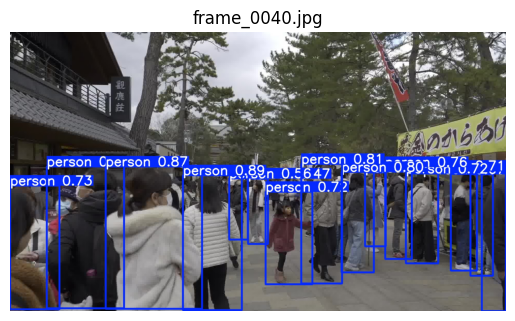

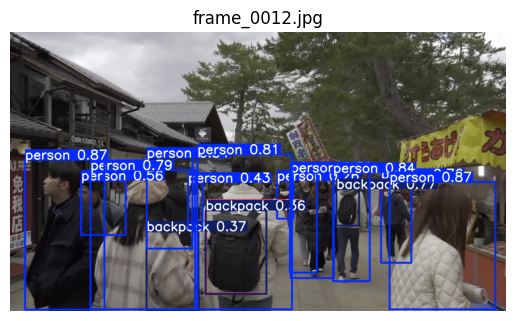

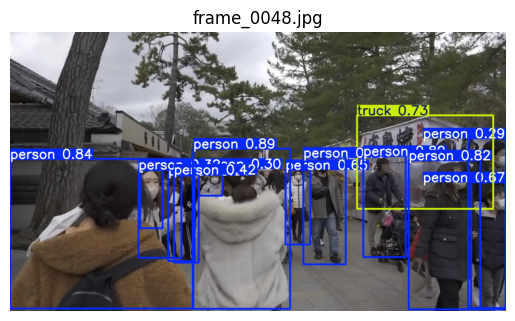

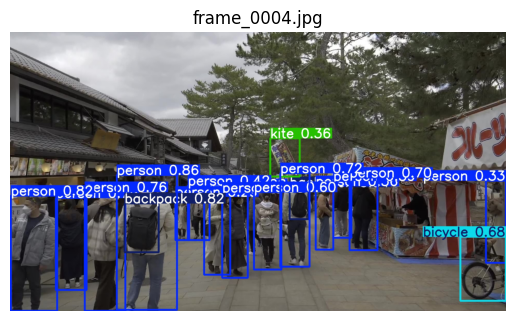

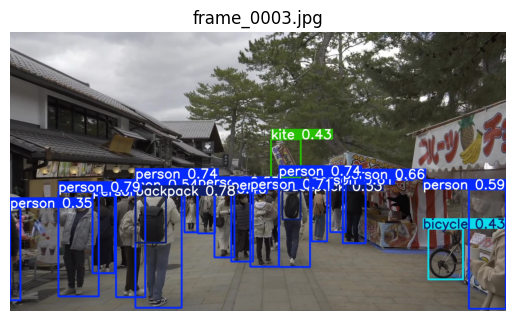

...

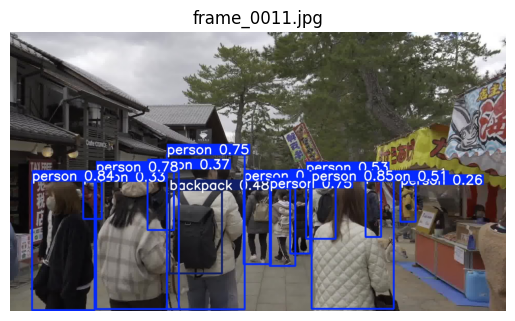

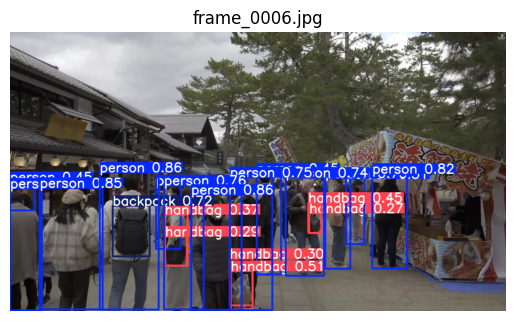

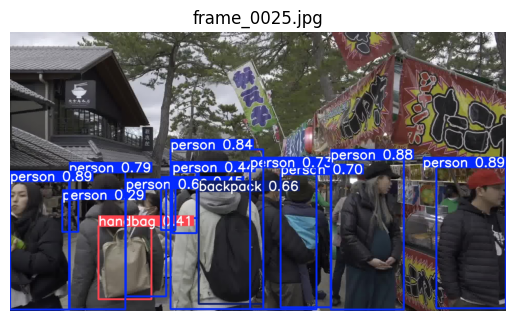

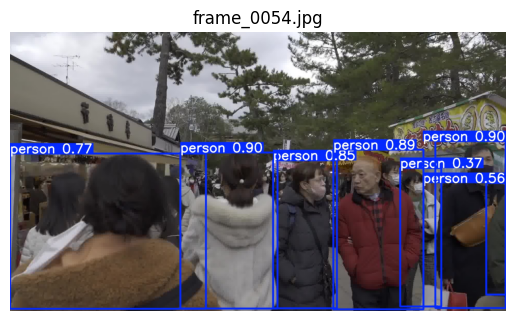

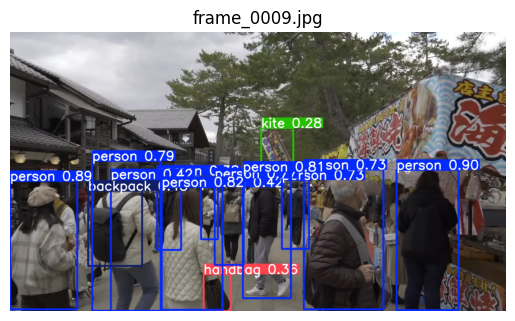

In [25]:
import cv2
import matplotlib.pyplot as plt
import glob

image_paths = glob.glob('runs/detect/predict/*.jpg')

for img_path in image_paths[:59]:  # Show first 5 images
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.axis('off')
    plt.title(os.path.basename(img_path))
    plt.show()


In [26]:
import os
import shutil
from pathlib import Path

# Source directory where your annotated images are located
source_dir = '/content/runs/detect/predict'  # update this if your path is different
# Destination directory to collect all images
destination_dir = '/content/annotated_images'

# Create the destination directory if it doesn't exist
os.makedirs(destination_dir, exist_ok=True)

# Copy all JPG files from source to destination
for file_name in os.listdir(source_dir):
    if file_name.endswith('.jpg'):
        full_file_name = os.path.join(source_dir, file_name)
        shutil.copy(full_file_name, os.path.join(destination_dir, file_name))

print(f"✅ All annotated images copied to: {destination_dir}")


✅ All annotated images copied to: /content/annotated_images


In [27]:
import shutil

shutil.make_archive('/content/annotated_images_zip', 'zip', '/content/annotated_images')


'/content/annotated_images_zip.zip'

In [28]:
from google.colab import files
files.download('/content/annotated_images_zip.zip')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [29]:
import cv2
import glob

img_folder = '/content/annotated_images'
video_output_path = '/content/annotated_output_video.mp4'

# Get list of image files
images = sorted(glob.glob(f"{img_folder}/*.jpg"))

# Set video parameters
frame = cv2.imread(images[0])
height, width, _ = frame.shape
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
video = cv2.VideoWriter(video_output_path, fourcc, 2, (width, height))  # 2 fps

# Write frames
for image in images:
    video.write(cv2.imread(image))

video.release()
print("✅ Video saved:", video_output_path)


✅ Video saved: /content/annotated_output_video.mp4


In [30]:
from google.colab import files

# Download the annotated video
files.download('/content/annotated_output_video.mp4')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [32]:
from ultralytics import YOLO
import cv2
import os

# Load model
model = YOLO("yolov8n.pt")  # use your custom model if needed

# Paths
image_folder = "/content/images/images"  # double check this path!
output_folder = "/content/numbered_annotated_images"
os.makedirs(output_folder, exist_ok=True)

# Get class names
class_names = model.names

# Sort image names and loop
image_files = sorted([f for f in os.listdir(image_folder) if f.lower().endswith((".jpg", ".jpeg", ".png"))])

for i, img_name in enumerate(image_files):
    img_path = os.path.join(image_folder, img_name)
    img = cv2.imread(img_path)

    if img is None:
        print(f"❌ Skipped unreadable image: {img_path}")
        continue

    # Run inference
    results = model(img_path)[0]

    # Draw boxes
    for box in results.boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0])
        cls = int(box.cls[0])
        label = class_names[cls]  # only the class name

        cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(img, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2)

    # Save with numbered filename
    save_path = os.path.join(output_folder, f"{i+1}.jpg")
    cv2.imwrite(save_path, img)

print("✅ All valid images processed and saved.")



image 1/1 /content/images/images/frame_0001.jpg: 384x640 17 persons, 2 backpacks, 142.9ms
Speed: 3.9ms preprocess, 142.9ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/images/images/frame_0002.jpg: 384x640 16 persons, 129.6ms
Speed: 2.7ms preprocess, 129.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/images/images/frame_0003.jpg: 384x640 15 persons, 1 bicycle, 2 backpacks, 1 kite, 124.0ms
Speed: 2.7ms preprocess, 124.0ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/images/images/frame_0004.jpg: 384x640 14 persons, 1 bicycle, 2 backpacks, 1 kite, 124.7ms
Speed: 2.7ms preprocess, 124.7ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/images/images/frame_0005.jpg: 384x640 13 persons, 2 backpacks, 2 kites, 125.1ms
Speed: 2.8ms preprocess, 125.1ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/i

In [33]:
import cv2
import os
from glob import glob

# Path to the folder with annotated images
image_folder = "/content/numbered_annotated_images"
output_video_path = "/content/annotated_video.mp4"

# Get all image paths and sort numerically by filename
image_paths = sorted(glob(os.path.join(image_folder, "*.jpg")), key=lambda x: int(os.path.basename(x).split(".")[0]))

# Read first image to get size
frame = cv2.imread(image_paths[0])
height, width, _ = frame.shape

# Define video writer
out = cv2.VideoWriter(output_video_path, cv2.VideoWriter_fourcc(*'mp4v'), 10, (width, height))

# Write each frame
for path in image_paths:
    img = cv2.imread(path)
    if img is not None:
        out.write(img)

out.release()
print("🎥 Video saved to:", output_video_path)


🎥 Video saved to: /content/annotated_video.mp4


In [34]:
from IPython.display import Video
Video("/content/annotated_video.mp4", embed=True)


In [35]:
from google.colab import files
files.download('/content/annotated_video.mp4')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [36]:
import shutil

# Zip the folder
shutil.make_archive("/content/annotated_images", 'zip', "/content/numbered_annotated_images")


'/content/annotated_images.zip'

In [37]:
from google.colab import files

# Download the zip
files.download("/content/annotated_images.zip")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>